In [133]:
%matplotlib notebook

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl

import time
import pickle
import matplotlib.colors as mcolors

from pathlib import Path

In [53]:
import nltk
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
from nltk import pos_tag, word_tokenize

# Download necessary NLTK data
nltk.download("averaged_perceptron_tagger")
nltk.download("wordnet")
nltk.download("punkt")

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/sdoneva/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to /Users/sdoneva/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to /Users/sdoneva/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [54]:
import black
import jupyter_black

jupyter_black.load(line_length=79)

In [55]:
%load_ext autoreload
%autoreload 2

import src
from src.plotting import (
    automatic_coloring,
    improved_coloring,
    years_coloring,
    plot_tsne_colors,
    plot_label_tags,
    plot_tsne_years,
)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [59]:
variables_path = Path("./data/variables")
figures_path = Path("./viz/embeddings")
embeddings_data_path = Path("data/embeddings/")

# Colors

In [84]:
col_to_use_for_color = "highest_level_path"

## Import data

In [206]:
df = pd.read_csv("data/output/df_for_dashboard_with_tsne.csv")

In [208]:
df.head()

,pmid,title,pmid_gene,pmid_title_gene_path,pmid_title_gene_go_process,gene,disease,highest_level_path,GO_biological_process_first,pubdate,journal,x_go_process,y_go_process,x_tsne,y_tsne
0,7866404,Autosomal dominant spondylarthropathy due to a...,PMID:7866404|GENE:COL2A1,7866404: Autosomal dominant spondylarthropathy...,7866404: Autosomal dominant spondylarthropathy...,COL2A1,Kniest Dysplasia,Developmental Biology,Skeletal System Development,1994,Human mutation,-2.670669,4.747370,28.514980,-65.738569
1,7866411,Phenylketonuria in southern Poland: a new spli...,PMID:7866411|GENE:PAH,7866411: Phenylketonuria in southern Poland: a...,7866411: Phenylketonuria in southern Poland: a...,PAH,Non-Phenylketonuria Hyperphenylalaninemia,Metabolism,Amino Acid Metabolic Process,1994,Human mutation,6.818430,6.972187,132.628590,25.220328
2,7868125,Elongated CAG repeats of the B37 gene in a Dan...,PMID:7868125|GENE:ATN1,7868125: Elongated CAG repeats of the B37 gene...,7868125: Elongated CAG repeats of the B37 gene...,ATN1,"Congenital Hypotonia, Epilepsy, Developmental ...",Signal Transduction,Central Nervous System Development,1995,Human genetics,0.665949,-10.189201,-115.404690,9.416150
3,7870075,A novel mutation in the fibrillin gene (FBN1) ...,PMID:7870075|GENE:FBN1,7870075: A novel mutation in the fibrillin gen...,7870075: A novel mutation in the fibrillin gen...,FBN1,Marfan Syndrome,Metabolism of Proteins,Skeletal System Development,1994,Molecular and cellular probes,-2.789018,4.739131,-7.721526,-68.590372
4,7874109,RET proto-oncogene mutations in French MEN 2A ...,PMID:7874109|GENE:RET,7874109: RET proto-oncogene mutations in Frenc...,7874109: RET proto-oncogene mutations in Frenc...,RET,Multiple Endocrine Neoplasia Iib,Developmental Biology,Positive Regulation of DNA-templated Transcrip...,1994,Human molecular genetics,4.672152,-0.382018,79.324284,-96.366498


In [91]:
df.shape

(44508, 13)

In [210]:
df[col_to_use_for_color].unique()

array(['Developmental Biology', 'Metabolism', 'Signal Transduction',
       'Metabolism of Proteins', 'Muscle Contraction', 'Disease',
       'Unknown Class', 'Cytosolic Sensors of Pathogen-Associated DNA',
       'Membrane Trafficking', 'Transport of Small Molecules',
       'Metabolism of RNA', 'RNA Polymerase II Transcription',
       'Cilium Assembly', 'Neuronal System',
       'Gene Expression (Transcription)', 'Diseases of Metabolism',
       'Chromatin Modifying Enzymes', 'Protein Localization',
       'Extracellular Matrix Organization', 'Cell Cycle',
       'Cellular Responses to Stimuli', 'Nephrin Family Interactions',
       'TRAF6 Mediated NF-kB Activation',
       'Platelet Activation, Signaling and Aggregation', 'Immune System',
       'DNA Repair', 'Cytokine Signaling in Immune System',
       'Sensory Processing of Sound', 'Interferon Signaling',
       'Hemostasis', 'Macroautophagy',
       'Antiviral Mechanism by IFN-stimulated Genes',
       'Cell-Cell Communication'

In [212]:
len(df[col_to_use_for_color].unique())

39

In [214]:
list(df[col_to_use_for_color].unique()[1:])

['Metabolism',
 'Signal Transduction',
 'Metabolism of Proteins',
 'Muscle Contraction',
 'Disease',
 'Unknown Class',
 'Cytosolic Sensors of Pathogen-Associated DNA',
 'Membrane Trafficking',
 'Transport of Small Molecules',
 'Metabolism of RNA',
 'RNA Polymerase II Transcription',
 'Cilium Assembly',
 'Neuronal System',
 'Gene Expression (Transcription)',
 'Diseases of Metabolism',
 'Chromatin Modifying Enzymes',
 'Protein Localization',
 'Extracellular Matrix Organization',
 'Cell Cycle',
 'Cellular Responses to Stimuli',
 'Nephrin Family Interactions',
 'TRAF6 Mediated NF-kB Activation',
 'Platelet Activation, Signaling and Aggregation',
 'Immune System',
 'DNA Repair',
 'Cytokine Signaling in Immune System',
 'Sensory Processing of Sound',
 'Interferon Signaling',
 'Hemostasis',
 'Macroautophagy',
 'Antiviral Mechanism by IFN-stimulated Genes',
 'Cell-Cell Communication',
 'The Canonical Retinoid Cycle in Rods (Twilight Vision)',
 'Apoptotic Execution Phase',
 'Lectin Pathway of C

## Preprocess

In [217]:
# Function to lemmatize a sentence
def lemmatize_sentence(sentence):
    lemmatizer = WordNetLemmatizer()
    # Tokenize the sentence
    tokens = word_tokenize(sentence)
    # Lemmatize each token with its correct POS tag
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]
    # Combine the lemmatized tokens back into a single string
    return " ".join(lemmatized_tokens)

In [219]:
# df["lemmatized_trial_title_summary"] = df["trial_title_summary"].apply(
#    lambda x: lemmatize_sentence(x)
# )

In [221]:
# df.to_csv("df_with_lemma.csv")

## Optional: Colors based on keywords

### Conditions

In [225]:
"""
Description of colors and words below.

Colors:
-chosen_colors: colors chosen manually from Scanpy colors selection
(originally from http://godsnotwheregodsnot.blogspot.com/2013/11/kmeans-color-quantization-seeding.html)

Words:
-words_capital: Words selected manually from the 100 most relevant words using threshold 0.1.
"""

# COLORS
chosen_colors = [
    "#FFB500",
    "#aeaa00",
    "#1CE6FF",
    "#FF34FF",
    "#FF4A46",
    "#008941",
    "#006FA6",
    "#0089A3",
    "#0000A6",
    "#B79762",
    "#004D43",
    "#8FB0FF",
    "#5A0007",
    "#BA0900",
    "#1B4400",
    "#4FC601",
    "#3B5DFF",
    "#00C2A0",
    "#549E79",
    "#BC23FF",
    "#C895C5",
    "#FF2F80",
    "#009271",
    "#00FECF",
    "#A4E804",
    "#6B002C",
    "#FF9408",
    "#CC0744",
    "#D790FF",
    "#5B4534",
    "#E83000",
    "#6F0062",
    "#b65141",
    "#C20078",
    "#7A4900",
    "#FF90C9",
    "#6508ba",
    "#0099FF",
    "#FF6E3A",
]
# WORDS
words = list(df[col_to_use_for_color].unique()[0:])

In [227]:
words

['Developmental Biology',
 'Metabolism',
 'Signal Transduction',
 'Metabolism of Proteins',
 'Muscle Contraction',
 'Disease',
 'Unknown Class',
 'Cytosolic Sensors of Pathogen-Associated DNA',
 'Membrane Trafficking',
 'Transport of Small Molecules',
 'Metabolism of RNA',
 'RNA Polymerase II Transcription',
 'Cilium Assembly',
 'Neuronal System',
 'Gene Expression (Transcription)',
 'Diseases of Metabolism',
 'Chromatin Modifying Enzymes',
 'Protein Localization',
 'Extracellular Matrix Organization',
 'Cell Cycle',
 'Cellular Responses to Stimuli',
 'Nephrin Family Interactions',
 'TRAF6 Mediated NF-kB Activation',
 'Platelet Activation, Signaling and Aggregation',
 'Immune System',
 'DNA Repair',
 'Cytokine Signaling in Immune System',
 'Sensory Processing of Sound',
 'Interferon Signaling',
 'Hemostasis',
 'Macroautophagy',
 'Antiviral Mechanism by IFN-stimulated Genes',
 'Cell-Cell Communication',
 'The Canonical Retinoid Cycle in Rods (Twilight Vision)',
 'Apoptotic Execution Pha

In [229]:
len(chosen_colors), len(words)

(39, 39)

In [231]:
colors_new_legend = dict(zip(words, chosen_colors))
len(colors_new_legend)

39

In [233]:
color_map = plt.cm.get_cmap("tab20", len(words))  # or 'hsv', 'tab10', etc.

colors_new_legend = {
    word: mcolors.to_hex(color_map(i)) for i, word in enumerate(words)
}

/var/folders/nd/2fzvhsh510gbt9x6z5pdb1gr0000gn/T/ipykernel_40619/637521071.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  color_map = plt.cm.get_cmap("tab20", len(words))  # or 'hsv', 'tab10', etc.


In [235]:
colors_new_legend

{'Developmental Biology': '#1f77b4',
 'Metabolism': '#1f77b4',
 'Signal Transduction': '#aec7e8',
 'Metabolism of Proteins': '#aec7e8',
 'Muscle Contraction': '#ff7f0e',
 'Disease': '#ff7f0e',
 'Unknown Class': '#ffbb78',
 'Cytosolic Sensors of Pathogen-Associated DNA': '#ffbb78',
 'Membrane Trafficking': '#2ca02c',
 'Transport of Small Molecules': '#2ca02c',
 'Metabolism of RNA': '#98df8a',
 'RNA Polymerase II Transcription': '#98df8a',
 'Cilium Assembly': '#d62728',
 'Neuronal System': '#d62728',
 'Gene Expression (Transcription)': '#ff9896',
 'Diseases of Metabolism': '#ff9896',
 'Chromatin Modifying Enzymes': '#9467bd',
 'Protein Localization': '#9467bd',
 'Extracellular Matrix Organization': '#c5b0d5',
 'Cell Cycle': '#8c564b',
 'Cellular Responses to Stimuli': '#8c564b',
 'Nephrin Family Interactions': '#c49c94',
 'TRAF6 Mediated NF-kB Activation': '#c49c94',
 'Platelet Activation, Signaling and Aggregation': '#e377c2',
 'Immune System': '#e377c2',
 'DNA Repair': '#f7b6d2',
 'Cyt

#### assign color

In [238]:
df.head()

,pmid,title,pmid_gene,pmid_title_gene_path,pmid_title_gene_go_process,gene,disease,highest_level_path,GO_biological_process_first,pubdate,journal,x_go_process,y_go_process,x_tsne,y_tsne
0,7866404,Autosomal dominant spondylarthropathy due to a...,PMID:7866404|GENE:COL2A1,7866404: Autosomal dominant spondylarthropathy...,7866404: Autosomal dominant spondylarthropathy...,COL2A1,Kniest Dysplasia,Developmental Biology,Skeletal System Development,1994,Human mutation,-2.670669,4.747370,28.514980,-65.738569
1,7866411,Phenylketonuria in southern Poland: a new spli...,PMID:7866411|GENE:PAH,7866411: Phenylketonuria in southern Poland: a...,7866411: Phenylketonuria in southern Poland: a...,PAH,Non-Phenylketonuria Hyperphenylalaninemia,Metabolism,Amino Acid Metabolic Process,1994,Human mutation,6.818430,6.972187,132.628590,25.220328
2,7868125,Elongated CAG repeats of the B37 gene in a Dan...,PMID:7868125|GENE:ATN1,7868125: Elongated CAG repeats of the B37 gene...,7868125: Elongated CAG repeats of the B37 gene...,ATN1,"Congenital Hypotonia, Epilepsy, Developmental ...",Signal Transduction,Central Nervous System Development,1995,Human genetics,0.665949,-10.189201,-115.404690,9.416150
3,7870075,A novel mutation in the fibrillin gene (FBN1) ...,PMID:7870075|GENE:FBN1,7870075: A novel mutation in the fibrillin gen...,7870075: A novel mutation in the fibrillin gen...,FBN1,Marfan Syndrome,Metabolism of Proteins,Skeletal System Development,1994,Molecular and cellular probes,-2.789018,4.739131,-7.721526,-68.590372
4,7874109,RET proto-oncogene mutations in French MEN 2A ...,PMID:7874109|GENE:RET,7874109: RET proto-oncogene mutations in Frenc...,7874109: RET proto-oncogene mutations in Frenc...,RET,Multiple Endocrine Neoplasia Iib,Developmental Biology,Positive Regulation of DNA-templated Transcrip...,1994,Human molecular genetics,4.672152,-0.382018,79.324284,-96.366498


In [240]:
df["assigned_color"] = (
    df[col_to_use_for_color].map(colors_new_legend).fillna("lightgray")
)  # Default color if not found

In [242]:
colors_new = list(df["assigned_color"])

In [244]:
df.head()

,pmid,title,pmid_gene,pmid_title_gene_path,pmid_title_gene_go_process,gene,disease,highest_level_path,GO_biological_process_first,pubdate,journal,x_go_process,y_go_process,x_tsne,y_tsne,assigned_color
0,7866404,Autosomal dominant spondylarthropathy due to a...,PMID:7866404|GENE:COL2A1,7866404: Autosomal dominant spondylarthropathy...,7866404: Autosomal dominant spondylarthropathy...,COL2A1,Kniest Dysplasia,Developmental Biology,Skeletal System Development,1994,Human mutation,-2.670669,4.747370,28.514980,-65.738569,#1f77b4
1,7866411,Phenylketonuria in southern Poland: a new spli...,PMID:7866411|GENE:PAH,7866411: Phenylketonuria in southern Poland: a...,7866411: Phenylketonuria in southern Poland: a...,PAH,Non-Phenylketonuria Hyperphenylalaninemia,Metabolism,Amino Acid Metabolic Process,1994,Human mutation,6.818430,6.972187,132.628590,25.220328,#1f77b4
2,7868125,Elongated CAG repeats of the B37 gene in a Dan...,PMID:7868125|GENE:ATN1,7868125: Elongated CAG repeats of the B37 gene...,7868125: Elongated CAG repeats of the B37 gene...,ATN1,"Congenital Hypotonia, Epilepsy, Developmental ...",Signal Transduction,Central Nervous System Development,1995,Human genetics,0.665949,-10.189201,-115.404690,9.416150,#aec7e8
3,7870075,A novel mutation in the fibrillin gene (FBN1) ...,PMID:7870075|GENE:FBN1,7870075: A novel mutation in the fibrillin gen...,7870075: A novel mutation in the fibrillin gen...,FBN1,Marfan Syndrome,Metabolism of Proteins,Skeletal System Development,1994,Molecular and cellular probes,-2.789018,4.739131,-7.721526,-68.590372,#aec7e8
4,7874109,RET proto-oncogene mutations in French MEN 2A ...,PMID:7874109|GENE:RET,7874109: RET proto-oncogene mutations in Frenc...,7874109: RET proto-oncogene mutations in Frenc...,RET,Multiple Endocrine Neoplasia Iib,Developmental Biology,Positive Regulation of DNA-templated Transcrip...,1994,Human molecular genetics,4.672152,-0.382018,79.324284,-96.366498,#1f77b4


In [246]:
cluster_sizes = df[col_to_use_for_color].value_counts()

# Optionally, to convert it back to a DataFrame for better visualization or further processing:
cluster_sizes_df = cluster_sizes.reset_index().rename(
    columns={"index": "Cluster", "cluster": "Size"}
)

print(cluster_sizes_df)

                                   highest_level_path  count
0                                          Metabolism   9876
1                                       Unknown Class   7916
2                                             Disease   7035
3                               Developmental Biology   6949
4                              Metabolism of Proteins   3245
5                                 Signal Transduction   2249
6                                     Neuronal System   1067
7                              Diseases of Metabolism    983
8                     RNA Polymerase II Transcription    970
9                                  Muscle Contraction    912
10                               Membrane Trafficking    858
11                       Transport of Small Molecules    855
12                                    Cilium Assembly    720
13                                         DNA Repair    563
14                                         Cell Cycle    536
15                      

In [248]:
# save results
np.save(variables_path / "colors_new", colors_new)

# save results
f = open(variables_path / "colors_new_legend.pkl", "wb")
pickle.dump(colors_new_legend, f)
f.close()

In [250]:
# load
# legend colors
pickle_in = open(variables_path / "colors_new_legend.pkl", "rb")
colors_new_legend = pickle.load(pickle_in)

colors_new = np.load(variables_path / "colors_new.npy", allow_pickle=True)

In [252]:
len(colors_new)

47809

In [254]:
len(tsne)

44508

In [256]:
len(colors_new_legend)

39

In [258]:
colors_new = np.array(colors_new)

In [260]:
figures_path

PosixPath('viz/embeddings')

### Interactive Plot

In [262]:
import plotly.io as pio

pio.renderers.default = "notebook"

In [266]:
import plotly.graph_objects as go

# Assuming your t-SNE data is stored in a variable named `tsne`
# And your DataFrame `df` contains a column 'study_official_title' for the official titles

fig = go.Figure()

# Add scatter plot for t-SNE data points
fig.add_trace(
    go.Scatter(
        x=tsne[:, 0],  # Use your t-SNE x coordinates
        y=tsne[:, 1],  # Use your t-SNE y coordinates
        mode="markers",
        marker=dict(
            color=colors_new,  # "RoyalBlue",  # Use a single color for all points
            size=10,  # Adjust the marker size here
            line=dict(width=1, color="DarkSlateGrey"),
        ),
        text=[
            f"<b>{nctid}:</b> {title}"
            for nctid, title in zip(df["pmid"], df["pmid_title_gene_path"])
        ],  # Combine NCT ID and title for hover text
        hovertemplate="%{text}<extra></extra>",
        showlegend=False,  # Hide the legend for data points
    )
)

# Update plot size here
fig.update_layout(
    title="t-SNE Visualization of ALL Studies",
    title_x=0.5,
    width=900,  # Set the width of the plot
    height=700,  # Set the height of the plot
)
# Show the figure
fig.show()

In [270]:
tsne = df_combined_for_dashboard[["x_tsne", "y_tsne"]].to_numpy()
# Assuming `tsne` is your 2D NumPy array of shape (n_samples, 2)
a, b = -10, 10  # Desired scale range

# Calculate min and max along each dimension (x and y)
xy_min = tsne.min(axis=0)
xy_max = tsne.max(axis=0)

# Apply min-max scaling
tsne_scaled = a + ((tsne - xy_min) / (xy_max - xy_min)) * (b - a)
tsne_scaled

array([[-1.4913538 , -4.57794372],
       [-8.26955916,  1.63256759],
       [ 7.8783826 ,  0.55348654],
       ...,
       [-6.74173516, -2.03387594],
       [ 5.30907094, -8.51198915],
       [-4.12991528,  5.79395424]])

<InteractiveFigure width=100% height=800>
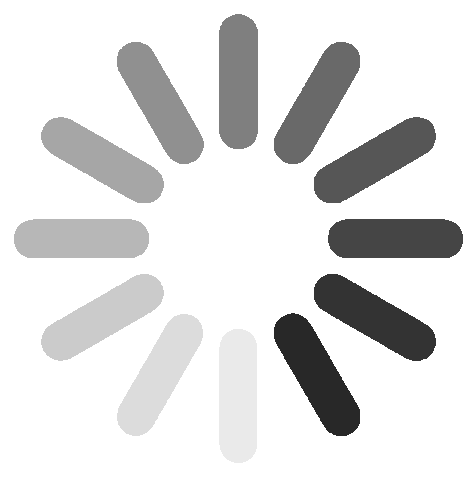

In [274]:
import datamapplot as dmp
import pandas as pd
import numpy as np

# Create datamapplot
interactive_fig = dmp.create_interactive_plot(
    tsne_scaled,
    df_combined_for_dashboard[col_to_use_for_color].to_numpy(),
    hover_text=df_combined_for_dashboard["pmid_title_gene_path"].to_numpy(),
    enable_search=True,
)

interactive_fig